In [1]:
# Import libraries

In [2]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder, OrdinalEncoder
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import MultinomialNB, GaussianNB
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix, f1_score, precision_score, recall_score

%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

- **Training Data**

In [3]:
# Read training data

In [21]:
Train_data = pd.read_csv('SalaryData_Train.csv')
Train_data

,age,workclass,education,educationno,maritalstatus,occupation,relationship,race,sex,capitalgain,capitalloss,hoursperweek,native,Salary
0,39,State-gov,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
1,50,Self-emp-not-inc,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
2,38,Private,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
3,53,Private,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
4,28,Private,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30156,27,Private,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,United-States,<=50K
30157,40,Private,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States,>50K
30158,58,Private,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,United-States,<=50K
30159,22,Private,HS-grad,9,Never-married,Adm-clerical,Own-child,White,Male,0,0,20,United-States,<=50K


In [5]:
# EDA

In [6]:
Train_data.shape

(30161, 14)

In [7]:
Train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30161 entries, 0 to 30160
Data columns (total 14 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   age            30161 non-null  int64 
 1   workclass      30161 non-null  object
 2   education      30161 non-null  object
 3   educationno    30161 non-null  int64 
 4   maritalstatus  30161 non-null  object
 5   occupation     30161 non-null  object
 6   relationship   30161 non-null  object
 7   race           30161 non-null  object
 8   sex            30161 non-null  object
 9   capitalgain    30161 non-null  int64 
 10  capitalloss    30161 non-null  int64 
 11  hoursperweek   30161 non-null  int64 
 12  native         30161 non-null  object
 13  Salary         30161 non-null  object
dtypes: int64(5), object(9)
memory usage: 3.2+ MB


In [8]:
Train_data.describe()

,age,educationno,capitalgain,capitalloss,hoursperweek
count,30161.000000,30161.000000,30161.000000,30161.000000,30161.000000
mean,38.438115,10.121316,1092.044064,88.302311,40.931269
std,13.134830,2.550037,7406.466611,404.121321,11.980182
min,17.000000,1.000000,0.000000,0.000000,1.000000
25%,28.000000,9.000000,0.000000,0.000000,40.000000
50%,37.000000,10.000000,0.000000,0.000000,40.000000
75%,47.000000,13.000000,0.000000,0.000000,45.000000
max,90.000000,16.000000,99999.000000,4356.000000,99.000000


In [9]:
Train_data.describe(include = 'O')

,workclass,education,maritalstatus,occupation,relationship,race,sex,native,Salary
count,30161,30161,30161,30161,30161,30161,30161,30161,30161
unique,7,16,7,14,6,5,2,40,2
top,Private,HS-grad,Married-civ-spouse,Prof-specialty,Husband,White,Male,United-States,<=50K
freq,22285,9840,14065,4038,12463,25932,20380,27504,22653


In [10]:
Train_data.isna().sum()

age              0
workclass        0
education        0
educationno      0
maritalstatus    0
occupation       0
relationship     0
race             0
sex              0
capitalgain      0
capitalloss      0
hoursperweek     0
native           0
Salary           0
dtype: int64

In [11]:
Train_data[Train_data.duplicated(keep = False)]

,age,workclass,education,educationno,maritalstatus,occupation,relationship,race,sex,capitalgain,capitalloss,hoursperweek,native,Salary
12,23,Private,Bachelors,13,Never-married,Adm-clerical,Own-child,White,Female,0,0,30,United-States,<=50K
16,32,Private,HS-grad,9,Never-married,Machine-op-inspct,Unmarried,White,Male,0,0,40,United-States,<=50K
19,40,Private,Doctorate,16,Married-civ-spouse,Prof-specialty,Husband,White,Male,0,0,60,United-States,>50K
25,19,Private,HS-grad,9,Never-married,Craft-repair,Own-child,White,Male,0,0,40,United-States,<=50K
27,49,Private,HS-grad,9,Married-civ-spouse,Craft-repair,Husband,White,Male,0,0,40,United-States,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30110,47,Private,HS-grad,9,Married-civ-spouse,Craft-repair,Husband,White,Male,0,0,40,United-States,<=50K
30118,20,Private,HS-grad,9,Never-married,Machine-op-inspct,Own-child,White,Male,0,0,40,United-States,<=50K
30132,22,Private,Some-college,10,Never-married,Adm-clerical,Own-child,White,Male,0,0,40,United-States,<=50K
30157,40,Private,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States,>50K


In [12]:
# Drop duplicates

In [13]:
Train_data.drop_duplicates(keep = 'first', inplace = True )
Train_data.reset_index(drop = True, inplace = True)
Train_data

,age,workclass,education,educationno,maritalstatus,occupation,relationship,race,sex,capitalgain,capitalloss,hoursperweek,native,Salary
0,39,State-gov,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
1,50,Self-emp-not-inc,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
2,38,Private,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
3,53,Private,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
4,28,Private,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26898,53,Private,Masters,14,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,40,United-States,>50K
26899,22,Private,Some-college,10,Never-married,Protective-serv,Not-in-family,White,Male,0,0,40,United-States,<=50K
26900,27,Private,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,United-States,<=50K
26901,58,Private,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,United-States,<=50K


In [14]:
# Data visualization

In [15]:
plt.rcParams['figure.figsize'] = (10,5)
plt.rcParams['figure.dpi'] = 250

Text(0.5, 1.0, 'Boxplot')

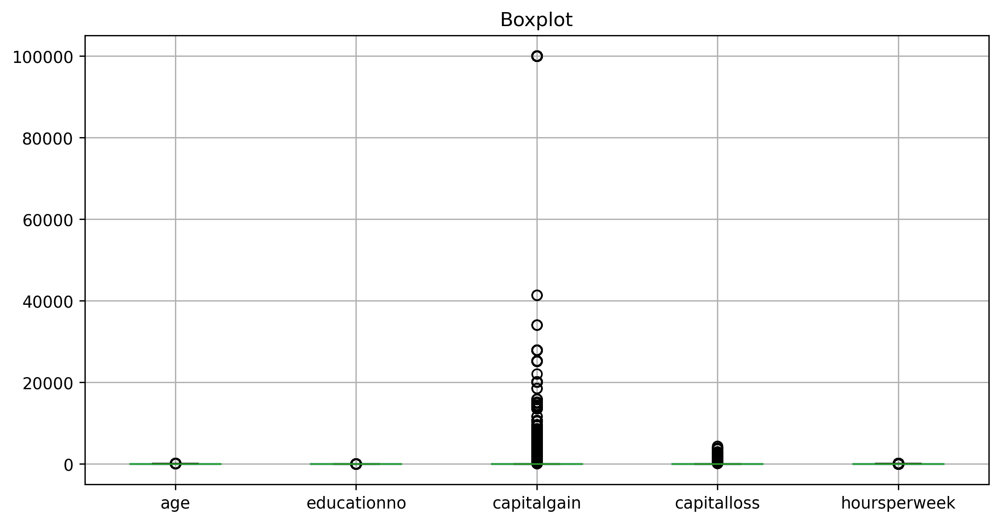

In [16]:
Train_data.boxplot()
plt.title('Boxplot')

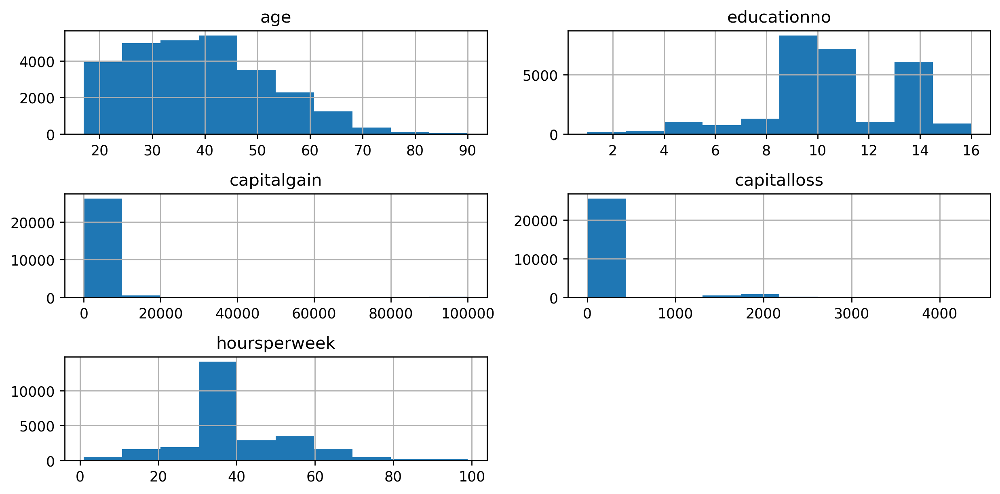

In [17]:
Train_data.hist()
plt.tight_layout()

In [18]:
x = pd.DataFrame()
x['education'] = Train_data['education'].unique()
x['educationno'] = Train_data['educationno'].unique()

x.sort_values('educationno', inplace = True)
x.reset_index(drop = True, inplace = True)
x

,education,educationno
0,Preschool,1
1,1st-4th,2
2,5th-6th,3
3,7th-8th,4
4,9th,5
5,10th,6
6,11th,7
7,12th,8
8,HS-grad,9
9,Some-college,10


Text(0.5, 1.0, 'Education')

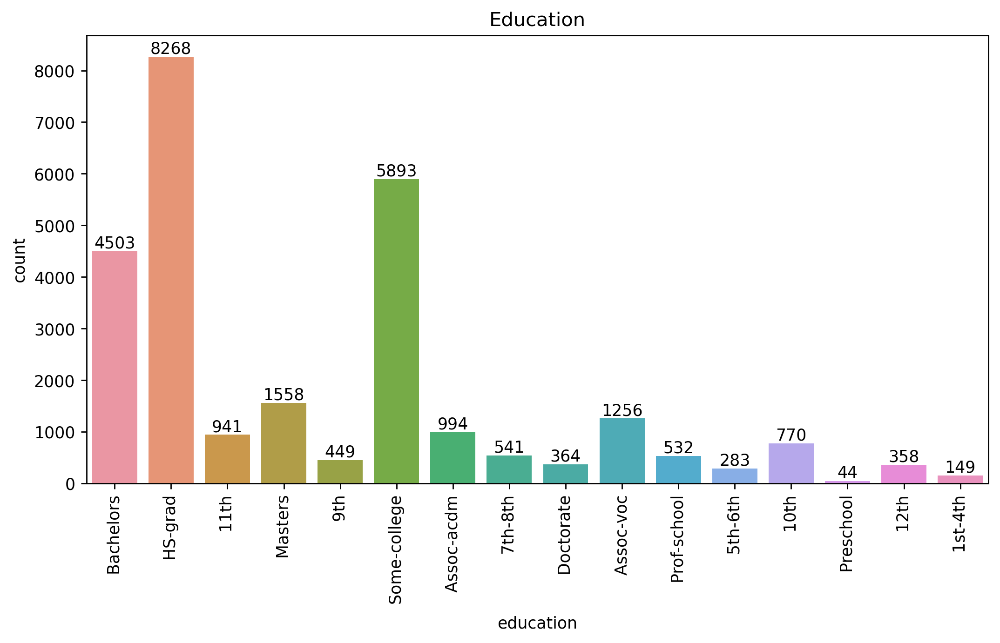

In [19]:
ax = sns.countplot(x ='education', orient = 'v', data = Train_data)
ax.bar_label(ax.containers[0])
plt.xticks(rotation = 90)
plt.title('Education')

In [23]:
# For education variable educationno is given, so droping education variable

In [24]:
Train_data.drop(columns = 'education', axis = 1, inplace = True)

In [25]:
# Ordinal encoding for in dependent variable

In [26]:
oe = OrdinalEncoder()

Train_data[['workclass', 'maritalstatus', 'occupation', 'relationship','race', 'sex', 'native']] = oe.fit_transform(Train_data[['workclass', 'maritalstatus', 'occupation', 'relationship','race', 'sex', 'native']])

In [50]:
# Label encoding for target variable

In [28]:
le = LabelEncoder()

Train_data['Salary'] = le.fit_transform(Train_data['Salary'])

In [29]:
Train_data

,age,workclass,educationno,maritalstatus,occupation,relationship,race,sex,capitalgain,capitalloss,hoursperweek,native,Salary
0,39,5.0,13,4.0,0.0,1.0,4.0,1.0,2174,0,40,37.0,0
1,50,4.0,13,2.0,3.0,0.0,4.0,1.0,0,0,13,37.0,0
2,38,2.0,9,0.0,5.0,1.0,4.0,1.0,0,0,40,37.0,0
3,53,2.0,7,2.0,5.0,0.0,2.0,1.0,0,0,40,37.0,0
4,28,2.0,13,2.0,9.0,5.0,2.0,0.0,0,0,40,4.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
30156,27,2.0,12,2.0,12.0,5.0,4.0,0.0,0,0,38,37.0,0
30157,40,2.0,9,2.0,6.0,0.0,4.0,1.0,0,0,40,37.0,1
30158,58,2.0,9,6.0,0.0,4.0,4.0,0.0,0,0,40,37.0,0
30159,22,2.0,9,4.0,0.0,3.0,4.0,1.0,0,0,20,37.0,0


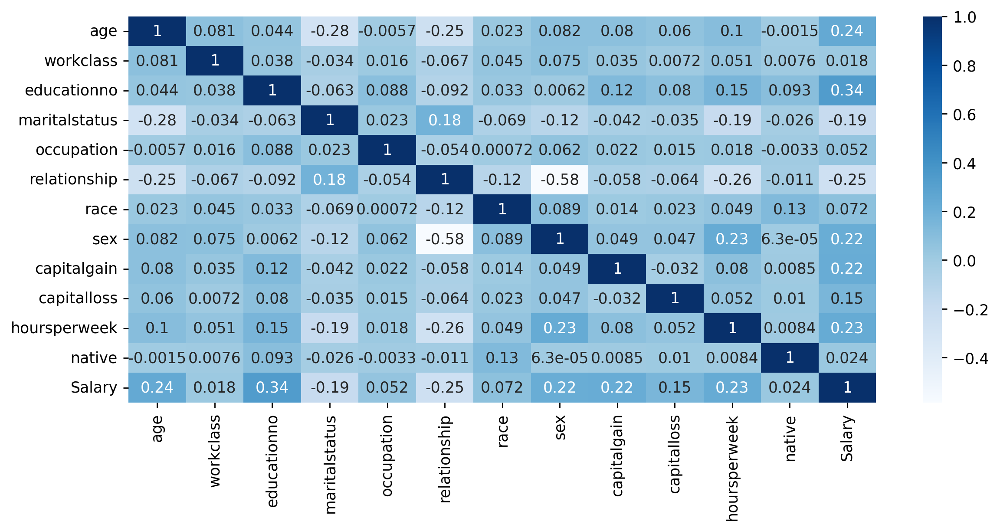

In [30]:
sns.heatmap(Train_data.corr(), annot = True, cmap = 'Blues')
plt.tight_layout()

In [31]:
sns.pairplot(Train_data, hue = 'Salary')

- **Testing Data**

In [ ]:
# Read Testing data

In [34]:
Test_data = pd.read_csv('SalaryData_Test.csv')
Test_data

,age,workclass,education,educationno,maritalstatus,occupation,relationship,race,sex,capitalgain,capitalloss,hoursperweek,native,Salary
0,25,Private,11th,7,Never-married,Machine-op-inspct,Own-child,Black,Male,0,0,40,United-States,<=50K
1,38,Private,HS-grad,9,Married-civ-spouse,Farming-fishing,Husband,White,Male,0,0,50,United-States,<=50K
2,28,Local-gov,Assoc-acdm,12,Married-civ-spouse,Protective-serv,Husband,White,Male,0,0,40,United-States,>50K
3,44,Private,Some-college,10,Married-civ-spouse,Machine-op-inspct,Husband,Black,Male,7688,0,40,United-States,>50K
4,34,Private,10th,6,Never-married,Other-service,Not-in-family,White,Male,0,0,30,United-States,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15055,33,Private,Bachelors,13,Never-married,Prof-specialty,Own-child,White,Male,0,0,40,United-States,<=50K
15056,39,Private,Bachelors,13,Divorced,Prof-specialty,Not-in-family,White,Female,0,0,36,United-States,<=50K
15057,38,Private,Bachelors,13,Married-civ-spouse,Prof-specialty,Husband,White,Male,0,0,50,United-States,<=50K
15058,44,Private,Bachelors,13,Divorced,Adm-clerical,Own-child,Asian-Pac-Islander,Male,5455,0,40,United-States,<=50K


In [32]:
# EDA

In [35]:
Test_data.shape

(15060, 14)

In [36]:
Test_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15060 entries, 0 to 15059
Data columns (total 14 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   age            15060 non-null  int64 
 1   workclass      15060 non-null  object
 2   education      15060 non-null  object
 3   educationno    15060 non-null  int64 
 4   maritalstatus  15060 non-null  object
 5   occupation     15060 non-null  object
 6   relationship   15060 non-null  object
 7   race           15060 non-null  object
 8   sex            15060 non-null  object
 9   capitalgain    15060 non-null  int64 
 10  capitalloss    15060 non-null  int64 
 11  hoursperweek   15060 non-null  int64 
 12  native         15060 non-null  object
 13  Salary         15060 non-null  object
dtypes: int64(5), object(9)
memory usage: 1.6+ MB


In [37]:
Test_data.describe()

,age,educationno,capitalgain,capitalloss,hoursperweek
count,15060.000000,15060.000000,15060.000000,15060.000000,15060.000000
mean,38.768327,10.112749,1120.301594,89.041899,40.951594
std,13.380676,2.558727,7703.181842,406.283245,12.062831
min,17.000000,1.000000,0.000000,0.000000,1.000000
25%,28.000000,9.000000,0.000000,0.000000,40.000000
50%,37.000000,10.000000,0.000000,0.000000,40.000000
75%,48.000000,13.000000,0.000000,0.000000,45.000000
max,90.000000,16.000000,99999.000000,3770.000000,99.000000


In [38]:
Test_data.describe(include = 'O')

,workclass,education,maritalstatus,occupation,relationship,race,sex,native,Salary
count,15060,15060,15060,15060,15060,15060,15060,15060,15060
unique,7,16,7,14,6,5,2,40,2
top,Private,HS-grad,Married-civ-spouse,Exec-managerial,Husband,White,Male,United-States,<=50K
freq,11021,4943,6990,1992,6203,12970,10147,13788,11360


In [39]:
Test_data.isna().sum()

age              0
workclass        0
education        0
educationno      0
maritalstatus    0
occupation       0
relationship     0
race             0
sex              0
capitalgain      0
capitalloss      0
hoursperweek     0
native           0
Salary           0
dtype: int64

In [40]:
Test_data[Test_data.duplicated(keep = False)]

,age,workclass,education,educationno,maritalstatus,occupation,relationship,race,sex,capitalgain,capitalloss,hoursperweek,native,Salary
29,26,Private,HS-grad,9,Divorced,Exec-managerial,Unmarried,White,Female,0,0,40,United-States,<=50K
33,20,Private,HS-grad,9,Never-married,Craft-repair,Own-child,White,Male,0,0,40,United-States,<=50K
37,29,Private,11th,7,Married-civ-spouse,Other-service,Husband,White,Male,0,0,40,United-States,<=50K
44,18,Private,Some-college,10,Never-married,Other-service,Own-child,White,Male,0,0,20,United-States,<=50K
49,21,Private,Some-college,10,Never-married,Adm-clerical,Own-child,White,Female,0,0,40,United-States,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15043,51,Private,HS-grad,9,Married-civ-spouse,Craft-repair,Husband,White,Male,0,0,40,United-States,<=50K
15044,22,Private,Some-college,10,Never-married,Craft-repair,Own-child,White,Male,0,0,40,United-States,<=50K
15049,32,Private,HS-grad,9,Married-civ-spouse,Handlers-cleaners,Husband,White,Male,0,0,40,United-States,<=50K
15052,31,Private,HS-grad,9,Married-civ-spouse,Craft-repair,Husband,White,Male,0,0,40,United-States,<=50K


In [42]:
Test_data.drop_duplicates(keep = 'first', inplace = True)
Test_data.reset_index(drop = True, inplace = True)
Test_data

,age,workclass,education,educationno,maritalstatus,occupation,relationship,race,sex,capitalgain,capitalloss,hoursperweek,native,Salary
0,25,Private,11th,7,Never-married,Machine-op-inspct,Own-child,Black,Male,0,0,40,United-States,<=50K
1,38,Private,HS-grad,9,Married-civ-spouse,Farming-fishing,Husband,White,Male,0,0,50,United-States,<=50K
2,28,Local-gov,Assoc-acdm,12,Married-civ-spouse,Protective-serv,Husband,White,Male,0,0,40,United-States,>50K
3,44,Private,Some-college,10,Married-civ-spouse,Machine-op-inspct,Husband,Black,Male,7688,0,40,United-States,>50K
4,34,Private,10th,6,Never-married,Other-service,Not-in-family,White,Male,0,0,30,United-States,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14125,33,Private,Bachelors,13,Never-married,Prof-specialty,Own-child,White,Male,0,0,40,United-States,<=50K
14126,39,Private,Bachelors,13,Divorced,Prof-specialty,Not-in-family,White,Female,0,0,36,United-States,<=50K
14127,38,Private,Bachelors,13,Married-civ-spouse,Prof-specialty,Husband,White,Male,0,0,50,United-States,<=50K
14128,44,Private,Bachelors,13,Divorced,Adm-clerical,Own-child,Asian-Pac-Islander,Male,5455,0,40,United-States,<=50K


In [33]:
# Data Visualization

Text(0.5, 1.0, 'Boxplot')

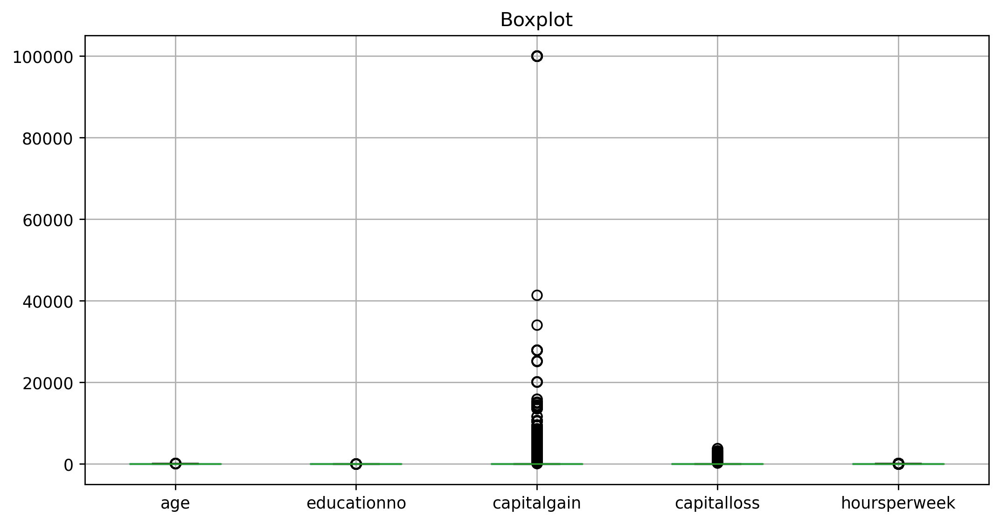

In [43]:
Test_data.boxplot()
plt.title('Boxplot')

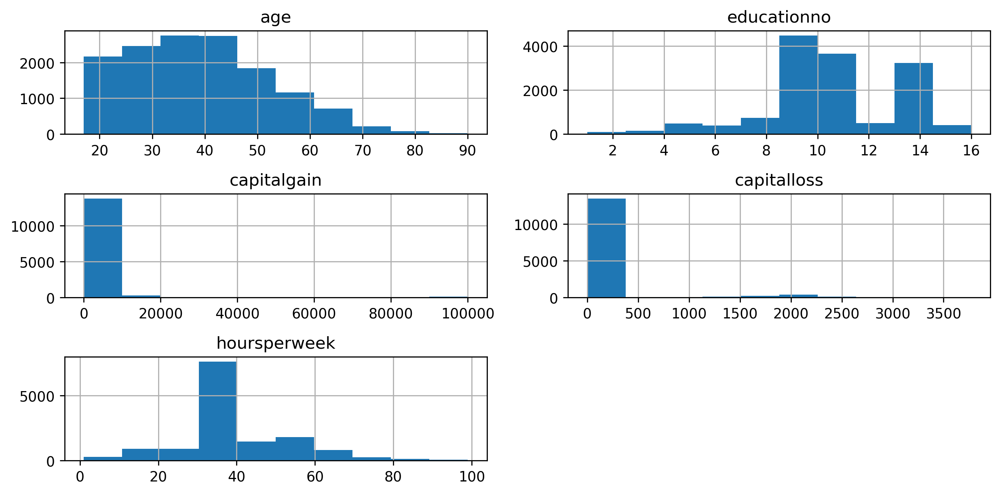

In [44]:
Test_data.hist()
plt.tight_layout()

In [46]:
#For education variable education no is given, so droping education variable

In [47]:
Test_data.drop(columns = 'education', axis = 1, inplace = True)

In [48]:
# Ordinal encoding for independent variable 

In [49]:
oe = OrdinalEncoder()

Test_data[['workclass', 'maritalstatus', 'occupation', 'relationship', 'race', 'sex', 'native']] = oe.fit_transform(Test_data[['workclass', 'maritalstatus', 'occupation', 'relationship', 'race', 'sex', 'native']])

In [51]:
# Label encoding for target variable

In [52]:
le = LabelEncoder()

Test_data['Salary'] = le.fit_transform(Test_data['Salary'])

In [53]:
Test_data

,age,workclass,educationno,maritalstatus,occupation,relationship,race,sex,capitalgain,capitalloss,hoursperweek,native,Salary
0,25,2.0,7,4.0,6.0,3.0,2.0,1.0,0,0,40,37.0,0
1,38,2.0,9,2.0,4.0,0.0,4.0,1.0,0,0,50,37.0,0
2,28,1.0,12,2.0,10.0,0.0,4.0,1.0,0,0,40,37.0,1
3,44,2.0,10,2.0,6.0,0.0,2.0,1.0,7688,0,40,37.0,1
4,34,2.0,6,4.0,7.0,1.0,4.0,1.0,0,0,30,37.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
14125,33,2.0,13,4.0,9.0,3.0,4.0,1.0,0,0,40,37.0,0
14126,39,2.0,13,0.0,9.0,1.0,4.0,0.0,0,0,36,37.0,0
14127,38,2.0,13,2.0,9.0,0.0,4.0,1.0,0,0,50,37.0,0
14128,44,2.0,13,0.0,0.0,3.0,1.0,1.0,5455,0,40,37.0,0


<function matplotlib.pyplot.tight_layout(*, pad=1.08, h_pad=None, w_pad=None, rect=None)>

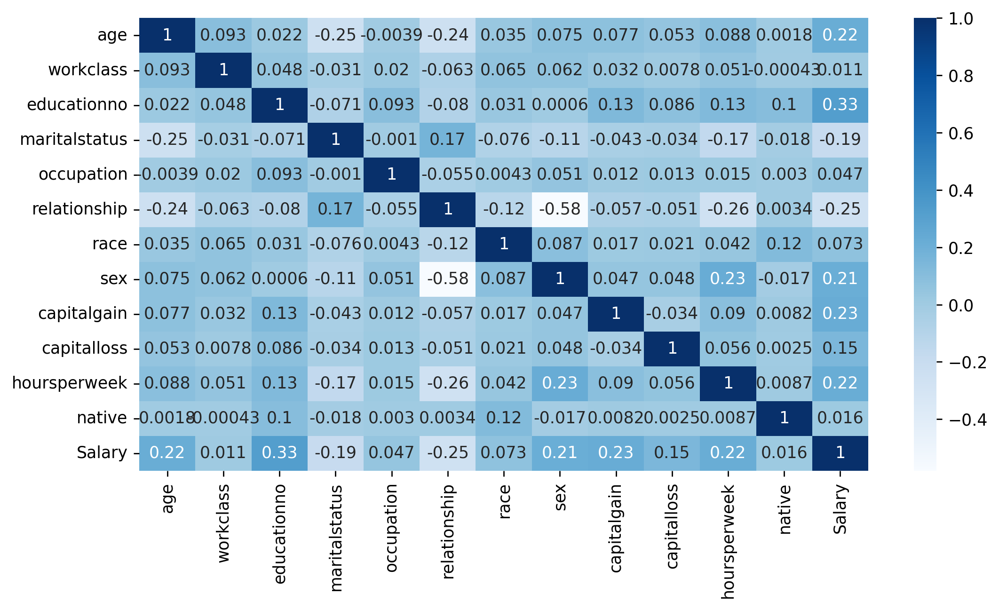

In [54]:
sns.heatmap(Test_data.corr(), annot = True, cmap = 'Blues')
plt.tight_layout

In [55]:
sns.pairplot(Test_data, hue = 'Salary')

In [57]:
# Data splitting into training and testing

In [58]:
xtrain = Train_data.iloc[:,0:-1]
xtest = Test_data.iloc[:,0:-1]
ytrain = Train_data['Salary']
ytest = Test_data['Salary']

In [59]:
# Model building

- **Multinomial Bayes**

In [61]:
model = MultinomialNB()

model.fit(xtrain, ytrain)
ypred = model.predict(xtest)

In [62]:
confusion_matrix(ytest, ypred)

array([[10151,   469],
       [ 2733,   777]], dtype=int64)

In [63]:
print('Accuracy Score: ', round(accuracy_score(ytest, ypred), 2))
print('Precision Score: ', round(precision_score(ytest, ypred), 2))
print('Recall Score: ', round(recall_score(ytest, ypred), 2))
print('F1 Score: ', round(f1_score(ytest, ypred), 2))

Accuracy Score:  0.77
Precision Score:  0.62
Recall Score:  0.22
F1 Score:  0.33


- **Gaussian Naive Bayes**

In [64]:
model1 = GaussianNB()

model1.fit(xtrain, ytrain)
ypred1 = model1.predict(xtest)

In [65]:
confusion_matrix(ytest, ypred1)

array([[10032,   588],
       [ 2337,  1173]], dtype=int64)

In [66]:
print('Accuracy Score: ', round(accuracy_score(ytest, ypred1), 2))
print('Precision Score: ', round(precision_score(ytest, ypred1), 2))
print('Recall Score: ', round(recall_score(ytest, ypred1), 2))
print('F1 Score: ', round(f1_score(ytest, ypred1), 2))

Accuracy Score:  0.79
Precision Score:  0.67
Recall Score:  0.33
F1 Score:  0.45
